<div style="display: flex; align-items: center; justify-content: center; flex-wrap: wrap;">
    <div style="flex: 1; max-width: 400px; display: flex; justify-content: center;">
        <img src="https://i.ibb.co/JBPWVYR/Logo-Nova-IMS-Black.png" style="max-width: 50%; height: auto; margin-top: 50px; margin-bottom: 50px;margin-left: 6rem;">
    </div>
    <div style="flex: 2; text-align: center; margin-top: 20px;margin-left: 8rem;">
        <div style="font-size: 28px; font-weight: bold; line-height: 1.2;">
            <span style="color: #22c1c3;">DL Project |</span> <span style="color: #08529C;">Predicting Rare Species from Images using Deep Learning</span>
        </div>
        <div style="font-size: 17px; font-weight: bold; margin-top: 10px;">
            Spring Semester | 2024 - 2025
        </div>
        <div style="font-size: 17px; font-weight: bold;">
            Master in Data Science and Advanced Analytics
        </div>
        <div style="margin-top: 20px;">
            <div>André Silvestre, 20240502</div>
            <div>Diogo Duarte, 20240525</div>
            <div>Filipa Pereira, 20240509</div>
            <div>Maria Cruz, 20230760</div>
            <div>Umeima Mahomed, 20240543</div>
        </div>
        <div style="margin-top: 20px; font-weight: bold;">
            Group 37
        </div>
    </div>
</div>

<div style="background: linear-gradient(to right, #22c1c3, #27b1dd, #2d9cfd, #090979); 
            padding: 1px; color: white; border-radius: 500px; text-align: center;">
</div>

## **📚 Libraries Import**

In [ ]:
# System imports
import os
import random
import datetime
from tqdm import tqdm

from pathlib import Path        # For file path manipulations

# Data manipulation imports
import numpy as np
import pandas as pd  
import warnings
warnings.filterwarnings("ignore")

# Data visualization imports
import matplotlib.pyplot as plt
import seaborn as sns

# Deep learning imports
import tensorflow as tf
from tensorflow.keras.preprocessing.image import (
    load_img, img_to_array, save_img
)

# Image processing imports (Data Augmentation layers)
from tensorflow.keras.layers import (
    Resizing, Rescaling, CenterCrop, AutoContrast, Equalization, MixUp, 
    RandAugment, RandomBrightness, RandomColorDegeneration, RandomColorJitter, 
    RandomContrast, RandomCrop, RandomFlip, RandomGrayscale, RandomHue, 
    RandomRotation, RandomSaturation, RandomSharpness, 
    RandomShear, RandomTranslation, RandomZoom
)
from tensorflow.keras.models import Sequential      # To chain augmentation layers

# Image processing imports
from PIL import Image

# Set the style of the visualization
pd.set_option('future.no_silent_downcasting', True)   # use int instead of float in DataFrame
pd.set_option("display.max_columns", None)            # display all columns

# Disable warnings (FutureWarning)
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning)

# For better resolution plots
%config InlineBackend.figure_format = 'retina'
# Setting seaborn style
sns.set_theme(style="white")

# Set random seeds for reproducibility
tf.random.set_seed(2025)
np.random.seed(2025)
random.seed(2025)

2025-04-13 17:53:27.422019: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1744563207.597953   18505 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1744563207.646910   18505 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1744563208.028596   18505 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1744563208.028627   18505 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1744563208.028630   18505 computation_placer.cc:177] computation placer alr

In [2]:
# Check if TensorFlow is installed and CUDA is available
# Source: https://www.tensorflow.org/install/source?hl=pt-br#gpu_support_3
print("TensorFlow Version:", tf.__version__)
print("Is TensorFlow built with CUDA?", tf.test.is_built_with_cuda())
print("GPU Available:", tf.config.list_physical_devices('GPU'))
print("GPU Device Name:", tf.test.gpu_device_name())                                # (if error in Google Colab: Make sure your Hardware accelerator is set to GPU. 
                                                                                    # Runtime > Change runtime type > Hardware Accelerator)

TensorFlow Version: 2.19.0
Is TensorFlow built with CUDA? True
GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
GPU Device Name: /device:GPU:0


I0000 00:00:1744563212.910143   18505 gpu_device.cc:2019] Created device /device:GPU:0 with 3586 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6


In [3]:
# Extra: https://www.tensorflow.org/api_docs/python/tf/config/experimental/set_memory_growth
# If you’re using a GPU, TensorFlow might pre-allocate GPU memory, leaving less for CPU operations. 
# Enabling memory growth lets the GPU allocate only what’s needed.
if tf.test.is_built_with_cuda():
    gpus = tf.config.list_physical_devices('GPU')
    if gpus:
        tf.config.experimental.set_memory_growth(gpus[0], True)

<div style="background: linear-gradient(to right, #22c1c3, #27b1dd, #2d9cfd, #090979); 
            padding: 1px; color: white; border-radius: 500px; text-align: center;">
</div>

## **🧮 Import Databases**

In [4]:
# Define the path to the data
base_data_dir = Path("data/RareSpecies_Split")
train_dir = Path("data/RareSpecies_Split/train")
val_dir = Path("data/RareSpecies_Split/val")
test_dir = Path("data/RareSpecies_Split/test")

# For Google Collab
# train_dir = Path("/content/RareSpecies_Split/train")
# val_dir = Path("/content/RareSpecies_Split/val")
# test_dir = Path("/content/RareSpecies_Split/test")

In [5]:
# Image Generators 
n_classes = 202                                     # Number of classes (we already know this based on previous notebook)
image_size = (224, 224)                             # Image size (224x224)
img_height, img_width = image_size                  # Image dimensions
batch_size = 32                                     # Batch size
input_shape = (img_width, img_height, 3)            # Input shape of the model
value_range = (0.0, 1.0)                            # Range of pixel values

In [6]:
# Import custom module for importing data, visualization, and utilities
import utilities

In [7]:
# Get class names from directory
class_names = sorted(os.listdir(train_dir))
class_indices = {name: i for i, name in enumerate(class_names)}

# Import the image dataset from the directory
from utilities import load_images_from_directory
train_datagen, val_datagen, test_datagen = load_images_from_directory(train_dir, val_dir, test_dir,
                                                                      labels='inferred', label_mode='categorical', 
                                                                      class_names=class_names, color_mode='rgb',
                                                                      batch_size=batch_size, image_size=image_size, seed=2025, 
                                                                      interpolation='bilinear', crop_to_aspect_ratio=False, pad_to_aspect_ratio=False)

print(f"\nLoaded: Train ({train_datagen.cardinality().numpy() * batch_size}), "
        f"Val ({val_datagen.cardinality().numpy() * batch_size}), "
        f"Test ({test_datagen.cardinality().numpy() * batch_size})")

Found 9586 files belonging to 202 classes.


I0000 00:00:1744563214.399062   18505 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 3586 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6


Found 1198 files belonging to 202 classes.
Found 1199 files belonging to 202 classes.

Loaded: Train (9600), Val (1216), Test (1216)


In [8]:
# Inspect the dataset object
print(f"\nTrain Dataset: {train_datagen}")
print(f"\nTrain File Paths:")
print(train_datagen.file_paths[:3])
print(f"\nTrain Classes Names:")
print(train_datagen.class_names[:3])
print(f"\nNumber of Classes: {len(train_datagen.class_names)}")


Train Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 202), dtype=tf.float32, name=None))>

Train File Paths:
['data/RareSpecies_Split/train/chordata_vespertilionidae/21686384_327547_eol-full-size-copy.jpg', 'data/RareSpecies_Split/train/chordata_mimidae/22894726_1047771_eol-full-size-copy.jpg', 'data/RareSpecies_Split/train/chordata_daubentoniidae/29345771_324407_eol-full-size-copy.jpg']

Train Classes Names:
['arthropoda_apidae', 'arthropoda_attelabidae', 'arthropoda_carabidae']

Number of Classes: 202


In [9]:
# Check the shape of the data (batch_size, img_width, img_height, 3)
for x, y in train_datagen.take(1):
    print("Train batch shape:", x.shape, y.shape)
for x, y in val_datagen.take(1):
    print("Val batch shape:", x.shape, y.shape)
for x, y in test_datagen.take(1):
    print("Test batch shape:", x.shape, y.shape)

Train batch shape: (32, 224, 224, 3) (32, 202)


2025-04-13 17:53:38.032420: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Val batch shape: (32, 224, 224, 3) (32, 202)


2025-04-13 17:53:38.818517: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Test batch shape: (32, 224, 224, 3) (32, 202)


2025-04-13 17:53:41.304290: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


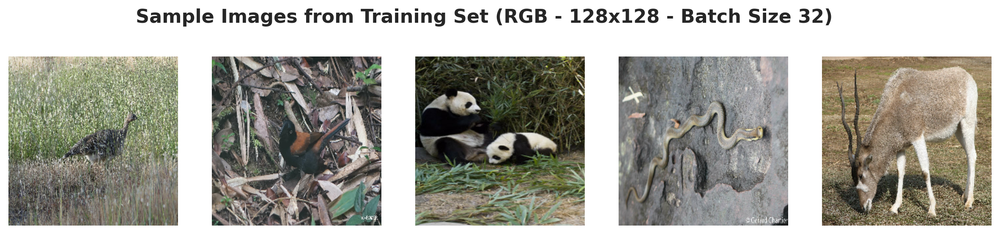

In [10]:
# Check 5 images from the training set

# Function to display images from a tf.data.Dataset
def show_images_from_dataset(dataset: tf.data.Dataset, num_images: int = 5, title: str = "Sample Images") -> None:
    """
    Displays a specified number of images from a tf.data.Dataset.
    
    Args:
        dataset (tf.data.Dataset): TensorFlow dataset containing images.
        num_images (int): Number of images to display. Default is 5.
        title (str): Title for the plot. Default is "Sample Images".
        
    Returns:
        None. Displays the images.
    """
    # Create a figure with subplots
    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 3, 3))
    
    # Loop through the dataset and display images
    for i, (image, label) in enumerate(dataset.take(num_images).as_numpy_iterator()):
        axes[i].imshow(image[0].astype(np.uint8))             # Display the image directly
        axes[i].axis('off')                                   # Remove axis for cleaner visualization
    
    plt.suptitle(title, fontsize=16, fontweight='bold', y=1.02)  # Set the title for the plot    
    plt.show()  # Show the plot
    
# Show 5 images from the training set
show_images_from_dataset(train_datagen, num_images=5, title="Sample Images from Training Set (RGB - 128x128 - Batch Size 32)")

Found 9586 files belonging to 202 classes.
Found 1198 files belonging to 202 classes.
Found 1199 files belonging to 202 classes.

Loaded: Train (9600), Val (1216), Test (1216)


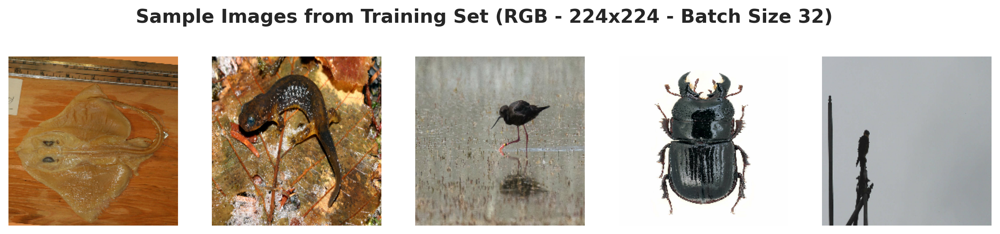

In [11]:
# Import the image dataset from the directory (224x224)
from utilities import load_images_from_directory

# Define the new image size
image_size = (224, 224)                             # Image size (224x224)
img_height, img_width = image_size                  # Image dimensions

train_datagen, val_datagen, test_datagen = load_images_from_directory(train_dir, val_dir, test_dir,
                                                                      labels='inferred', label_mode='categorical', color_mode='rgb',
                                                                      class_names=class_names, batch_size=batch_size,
                                                                      image_size=image_size, seed=2025, 
                                                                      interpolation='bilinear', 
                                                                      crop_to_aspect_ratio=False, pad_to_aspect_ratio=False)

print(f"\nLoaded: Train ({train_datagen.cardinality().numpy() * batch_size}), "
        f"Val ({val_datagen.cardinality().numpy() * batch_size}), "
        f"Test ({test_datagen.cardinality().numpy() * batch_size})")

# Show 5 images from the training set
show_images_from_dataset(train_datagen, num_images=5, title="Sample Images from Training Set (RGB - 224x224 - Batch Size 32)")

Found 9586 files belonging to 202 classes.
Found 1198 files belonging to 202 classes.
Found 1199 files belonging to 202 classes.

Loaded: Train (9600), Val (1216), Test (1216)


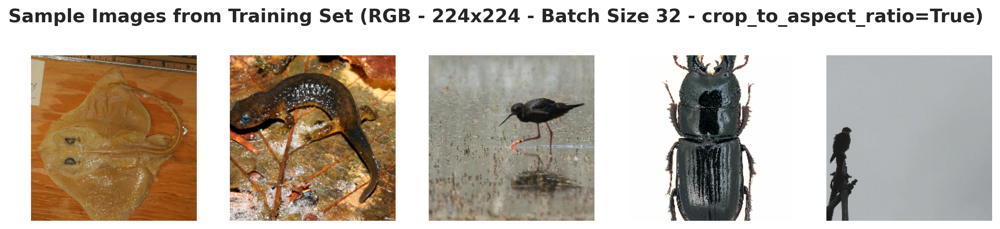

In [12]:
# Import the image dataset from the directory (224x224 - crop_to_aspect_ratio=True)
train_datagen, val_datagen, test_datagen = load_images_from_directory(train_dir, val_dir, test_dir,
                                                                      labels='inferred', label_mode='categorical', color_mode='rgb', 
                                                                      class_names=class_names, batch_size=batch_size, 
                                                                      image_size=image_size, seed=2025, 
                                                                      interpolation='bilinear', crop_to_aspect_ratio=True, pad_to_aspect_ratio=False)
print(f"\nLoaded: Train ({train_datagen.cardinality().numpy() * batch_size}), "
        f"Val ({val_datagen.cardinality().numpy() * batch_size}), "
        f"Test ({test_datagen.cardinality().numpy() * batch_size})")

# Show 5 images from the training set
show_images_from_dataset(train_datagen, num_images=5, title="Sample Images from Training Set (RGB - 224x224 - Batch Size 32 - crop_to_aspect_ratio=True)")

Found 9586 files belonging to 202 classes.
Found 1198 files belonging to 202 classes.
Found 1199 files belonging to 202 classes.

Loaded: Train (9600), Val (1216), Test (1216)


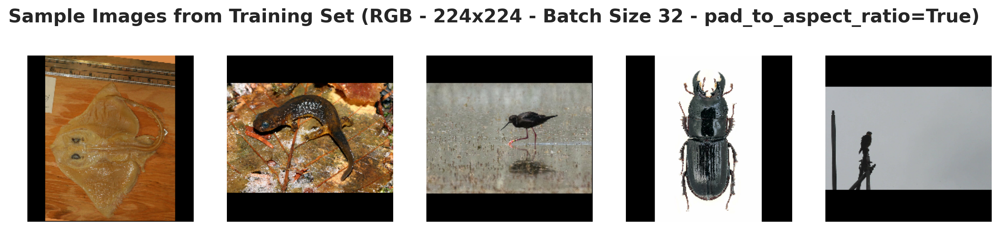

In [13]:
# Import the image dataset from the directory (224x224 - pad_to_aspect_ratio=True)
train_datagen, val_datagen, test_datagen = load_images_from_directory(train_dir, val_dir, test_dir,
                                                                      labels='inferred', label_mode='categorical', color_mode='rgb', 
                                                                      class_names=class_names, batch_size=batch_size, 
                                                                      image_size=image_size, seed=2025, 
                                                                      interpolation='bilinear', crop_to_aspect_ratio=False, pad_to_aspect_ratio=True)
print(f"\nLoaded: Train ({train_datagen.cardinality().numpy() * batch_size}), "
        f"Val ({val_datagen.cardinality().numpy() * batch_size}), "
        f"Test ({test_datagen.cardinality().numpy() * batch_size})")

# Show 5 images from the training set
show_images_from_dataset(train_datagen, num_images=5, title="Sample Images from Training Set (RGB - 224x224 - Batch Size 32 - pad_to_aspect_ratio=True)")

### **Justification for Setting `crop_to_aspect_ratio` and `pad_to_aspect_ratio` to False**

In our experiments, using `crop_to_aspect_ratio=True` resulted in resizing images by cropping parts of them to maintain the desired aspect ratio. This approach can lead to significant loss of important details — for example, in our fish images, essential features such as the head and tail were cropped out, potentially impairing model performance.

Conversely, when `pad_to_aspect_ratio=True` is used, the image is padded with black bars to reach the target aspect ratio. However, this introduces areas with uniform, non-informative pixel values that may bias the model's learning process, since the model considers the colors and patterns of each pixel.

> Thus, we opt to set both `crop_to_aspect_ratio` and `pad_to_aspect_ratio` to **False**. This way, the image is simply resized to the specified dimensions (as per `image_size`), preserving all original content. Although this might introduce some distortion, it is preferable in our case because it avoids both the loss of crucial information and the introduction of artificial artifacts. This approach ensures that all potentially relevant features are retained for the model to learn effectively.

# <a class='anchor' id='3'></a>
<br>
<style>
@import url('https://fonts.cdnfonts.com/css/avenir-next-lt-pro?styles=29974');
</style>

<div style="background: linear-gradient(to right, #22c1c3, #27b1dd, #2d9cfd, #090979); 
            padding: 10px; color: white; border-radius: 300px; text-align: center;">
    <center><h1 style="margin-left: 140px;margin-top: 10px; margin-bottom: 4px; color: white;
                       font-size: 32px; font-family: 'Avenir Next LT Pro', sans-serif;">
        <b>2 | Image Preprocessing & Data Augmentation</b></h1></center>
</div>

<br><br>

In [14]:
# Sample one image filepath from the training set
list(train_datagen.file_paths)[0]

'data/RareSpecies_Split/train/chordata_vespertilionidae/21686384_327547_eol-full-size-copy.jpg'

## **📷 Image Preprocessing** <sup>**[[1]](https://www.tensorflow.org/api_docs/python/tf/image)**</sup>

### **Transform the images to Grayscale**

In [15]:
def image_preprocessing_experiment(image_path='data/RareSpecies_Split/train/chordata_dactyloidae/29482917_453292_eol-full-size-copy.jpg'):
    """Tests key tf.image preprocessing functions on a sample image.
    
    Args:
        image_path (str): Path to the sample image.
    
    Returns:
        None: Displays a grid of transformed images.
    
    Notes:
        - Loads image, resizes to 224x224, rescales to [0, 1].
        - Applies selected tf.image transformations for classification robustness.
        - Plots in a 4xN grid for readability.
    """
    # Load and preprocess the image
    try:
        original_img = Image.open(image_path).convert('RGB')
        img = original_img.resize((224, 224))
        img_array = np.array(img).astype("float32") / 255.0
        img_array = tf.expand_dims(img_array, 0)  # Shape: (1, 224, 224, 3)
    except Exception as e:
        print(f"Error loading image: {e}")
        return

    # Define transformations from tf.image
    transformations = [
        ("Original (With Resize)", lambda x: x[0]),                                             # Unchanged image
        ("Adjust Brightness", lambda x: tf.image.adjust_brightness(x, delta=0.5)),              # Brighten by 0.5
        ("Adjust Contrast", lambda x: tf.image.adjust_contrast(x, contrast_factor=2.0)),        # Increase contrast
        ("Adjust Hue", lambda x: tf.image.adjust_hue(x, delta=0.3)),                            # Shift hue by 0.3
        ("Adjust Saturation", lambda x: tf.image.adjust_saturation(x, saturation_factor=2.0)),  # Double saturation
        ("Central Crop", lambda x: tf.image.central_crop(x, central_fraction=0.8)),             # Crop 80% central area
        ("Flip Left-Right", tf.image.flip_left_right),                                          # Horizontal flip
        ("Flip Up-Down", tf.image.flip_up_down),                                                # Vertical flip
        ("Random Brightness", lambda x: tf.image.random_brightness(x, max_delta=0.5)),          # Random ±0.5 brightness
        ("Random Contrast", lambda x: tf.image.random_contrast(x, lower=0.5, upper=2.0)),       # Random contrast 0.5-2.0
        ("Random Hue", lambda x: tf.image.random_hue(x, max_delta=0.3)),                        # Random ±0.3 hue
        ("Random Saturation", lambda x: tf.image.random_saturation(x, lower=0.5, upper=2.0)),   # Random saturation 0.5-2.0
        ("Random Crop", lambda x: tf.image.random_crop(x, size=[1, 200, 200, 3])),              # Crop to 200x200 randomly
        ("Resize", lambda x: tf.image.resize(x, size=[224, 224], method='bilinear')),           # Redundant but shown
        ("Rotate 90°", lambda x: tf.image.rot90(x, k=1)),                                       # Rotate 90° clockwise
        ("Grayscale", tf.image.rgb_to_grayscale),                                               # Convert to grayscale
        ("Transpose", tf.image.transpose)                                                       # Swap height and width
    ]

    # Apply transformations and store results
    transformed_imgs = []
    for name, transform in transformations:
        try:
            result = transform(img_array)
            # Ensure output is 224x224 (resize back if needed, e.g., after crop)
            if result.shape[1] != 224 or result.shape[2] != 224:
                result = tf.image.resize(result, [224, 224], method='bilinear')
                
            # Handle grayscale (1 channel) by converting back to 3 channels if needed
            if result.shape[-1] == 1:
                result = tf.image.grayscale_to_rgb(result)
                
            transformed_imgs.append((name, tf.squeeze(result).numpy()))
        except Exception as e:
            print(f"Error applying {name}: {e}")
            transformed_imgs.append((name, img_array[0].numpy()))  # Fallback to original

    # Plot in a CxR grid
    n_transforms = len(transformed_imgs)
    n_rows = 3 
    n_cols = (n_transforms + n_rows - 1) // n_rows  # Adjusted for R rows
    fig, ax = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3, n_rows * 3))
    for i, (title, img_data) in enumerate(transformed_imgs):
        row, col = divmod(i, n_cols)
        ax[row, col].imshow(np.clip(img_data, 0, 1))
        ax[row, col].set_title(title, fontsize=10, fontweight='bold')
        ax[row, col].axis('off')
    
    # Hide unused subplots
    for i in range(n_transforms, n_rows * n_cols):
        row, col = divmod(i, n_cols)
        ax[row, col].axis('off')
    
    # Adjust layout and display
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.suptitle("Preprocessing and Augmentation Effects (tf.image)", fontsize=16, fontweight='bold', y=1.05)
    plt.show()


Preprocessing Experiment (Image 1):


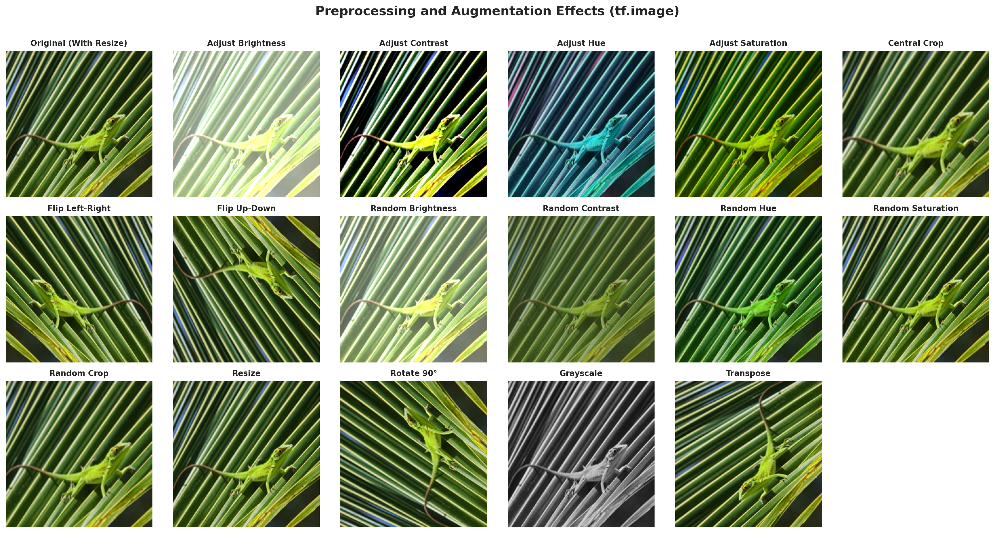


Preprocessing Experiment (Image 2):


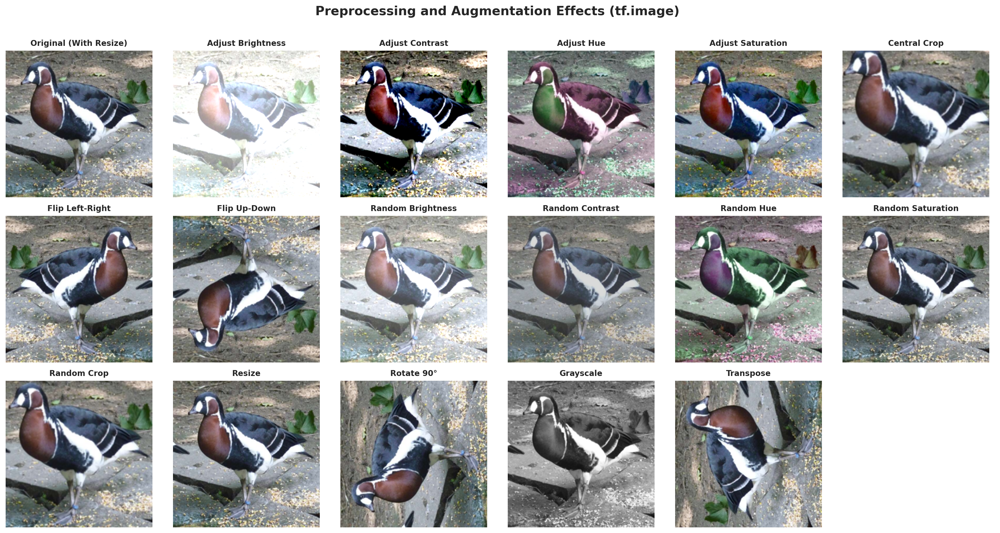

In [16]:
# Run the experiment with two example images
print("\nPreprocessing Experiment (Image 1):")
image_preprocessing_experiment()
print("\nPreprocessing Experiment (Image 2):")
image_preprocessing_experiment(image_path='data/RareSpecies_Split/train/chordata_anatidae/14020527_45513542_eol-full-size-copy.jpg')

> From the image preprocessing options tested among those available at https://www.tensorflow.org/api_docs/python/tf/image we decided to test the `tf.image.rgb_to_grayscale` function to convert the images to grayscale, `tf.image.adjust_contrast` to adjust the contrast, and `tf.image.adjust_saturation` to adjust the saturation. <br> <br>
> **NOTE:** This decision was based on the idea of distinguishing the object (animal) from the background, which empirically seems to be the preprocessing that most enhances this goal.

## **🖌️ Data Augmentation** <sup>**[[2]](https://www.tensorflow.org/tutorials/images/data_augmentation)**</sup>

In [17]:
def data_augmentation_experiment(image_path='data/RareSpecies_Split/train/chordata_dactyloidae/29482917_453292_eol-full-size-copy.jpg'):
    """Tests all Keras preprocessing and augmentation layers on a sample image with max effect (factor=1).
    
    Args:
        image_path (str): Path to the sample image.
    
    Returns:
        None: Displays multiple 2xN grids of transformed images.
    
    Notes:
        - Loads image, resizes to 224x224, rescales to [0, 1].
        - Applies all available Keras image preprocessing/augmentation layers.
        - Uses training=True for random layers to ensure application.
        - Splits into multiple 2-row grids for readability.
    """
    # Load and preprocess the image
    try:
        original_img = Image.open(image_path).convert('RGB')        # Ensure RGB format
        img = original_img.resize((224, 224))                       # Resize to 224x224
        img_array = np.array(img).astype("float32") / 255.0         # Rescale to [0, 1]
        img_array = tf.expand_dims(img_array, 0)                    # Add batch dimension
    except Exception as e:
        print(f"Error loading image: {e}")
        return

    # Define all preprocessing and augmentation layers with max effect
    transformations = [
        ("Original", lambda x: x[0]),                                           # Unchanged image
        ("Resized", Resizing(224, 224)),                                        # Resizes to specified dimensions (redundant here but shown)
        ("Rescaled", Rescaling(1./255)),                                        # Scales pixels to [0, 1] (redundant here)
        ("CenterCrop", CenterCrop(200, 200)),                                   # Crops center to 200x200
        ("AutoContrast", AutoContrast()),                                       # Maximizes contrast across the image
        ("Equalization", Equalization()),                                       # Equalizes histogram for contrast enhancement
        ("MixUp", MixUp(alpha=1.0)),                                            # Blends images (simplified for single image)
        ("RandAugment", RandAugment(value_range=(0, 1))),                       # Randomly applies augmentations at max magnitude
        ("Brightness", RandomBrightness(1.0)),                                  # Adjusts brightness by max factor
        ("ColorDegeneration", RandomColorDegeneration(factor=1.0)),             # Degenerates color to grayscale-like
        ("ColorJitter", RandomColorJitter(brightness_factor=1.0, 
                                          contrast_factor=1.0, 
                                          saturation_factor=1.0)),              # Max jitters brightness, contrast, saturation
        ("Contrast", RandomContrast(1.0)),                                      # Max contrast adjustment
        ("Crop", RandomCrop(200, 200)),                                         # Randomly crops to 200x200
        ("Flip", RandomFlip("horizontal_and_vertical")),                        # Flips both horizontally and vertically
        ("Grayscale", RandomGrayscale(factor=1.0)),                             # Converts to grayscale with 100% probability
        ("Hue", RandomHue(factor=0.5)),                                         # Shifts hue by max factor (0.5 is max valid range)
        ("Rotation", RandomRotation(1.0)),                                      # Rotates by up to 360 degrees (factor=1)
        ("Saturation", RandomSaturation(1.0)),                                  # Adjusts saturation by max factor
        ("Sharpness", RandomSharpness(1.0)),                                    # Enhances sharpness by max factor
        ("Shear", RandomShear(0.5)),                                            # Shears by max factor
        ("Translation", RandomTranslation(0.5, 0.5)),                           # Shifts by max horizontal/vertical factors
        ("Zoom", RandomZoom(0.5)),                                              # Zooms by max factor
    ]

    # Apply transformations and store results
    transformed_imgs = [("Original", np.array(original_img).astype("float32") / 255.0)]  # Add the original image first
    for name, layer in transformations:
        try:
            if name == "Original":
                continue                                                # Skip as it's already added
            result = layer(img_array, training=True)                    # Force application
            transformed_imgs.append((name, tf.squeeze(result).numpy()))
        except Exception as e:
            print(f"Error applying {name}: {e}")
            transformed_imgs.append((name, img_array[0].numpy()))  # Fallback to original

    # Plot in a CxR grid    
    n_transforms = len(transformed_imgs)
    n_rows = 3
    n_cols = (n_transforms + n_rows - 1) // n_rows
    fig, ax = plt.subplots(n_rows, n_cols, figsize=(n_cols * 3, n_rows * 3))
    for i, (title, img_data) in enumerate(transformed_imgs):
        row, col = divmod(i, n_cols)
        ax[row, col].imshow(np.clip(img_data, 0, 1))
        ax[row, col].set_title(title, fontsize=10, fontweight='bold')
        ax[row, col].axis('off')
    
    # Hide unused subplots
    for i in range(n_transforms, n_rows * n_cols):
        row, col = divmod(i, n_cols)
        ax[row, col].axis('off')
        
    # Adjust layout and display
    sns.despine(top=True, right=True)
    plt.tight_layout()
    plt.suptitle(f"Preprocessing and Augmentation Effects", fontsize=16, fontweight='bold', y=1.05)
    plt.show()


Preprocessing Experiment (Image 1):


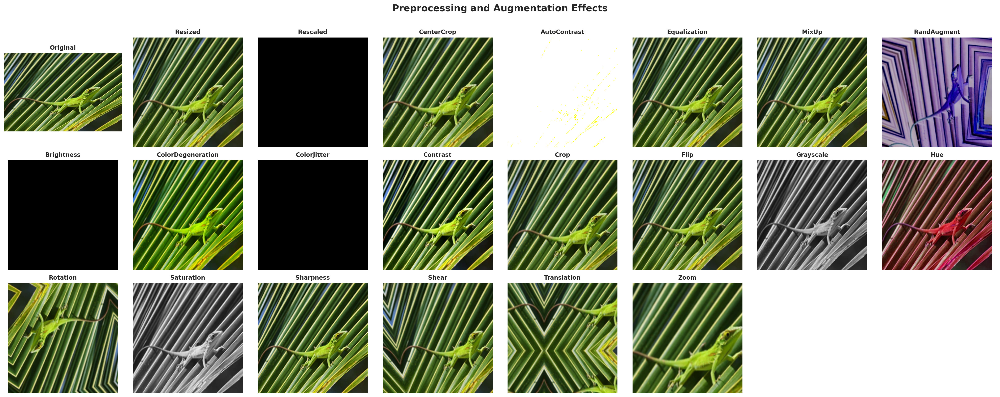


Preprocessing Experiment (Image 2):


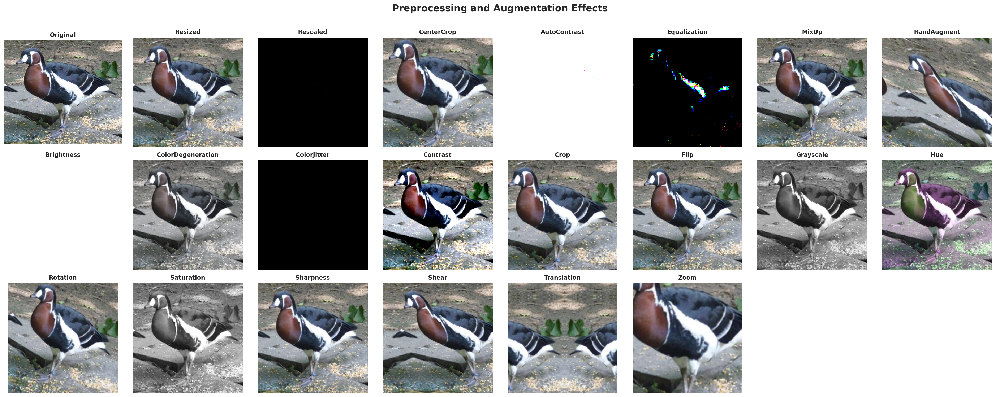

In [18]:
# Run the experiment with two example images
print("\nPreprocessing Experiment (Image 1):")
data_augmentation_experiment()
print("\nPreprocessing Experiment (Image 2):")
data_augmentation_experiment(image_path='data/RareSpecies_Split/train/chordata_anatidae/14020527_45513542_eol-full-size-copy.jpg')

> After applying **Data Augmentation** we decided to use this technique as a way of **OverSampling** our database for minority cases.

## **Data Imbalance**

#### **OverSampling | SMOTE Data Augmentation**

Duplicate the minorities classes to balance the dataset. We will use ***Data Augmentation*** to create new images from the original ones.

In [19]:
# Applying Random Augmentation to handle class imbalance
# Source Code: https://medium.com/@fatimazahra.belharar/enhancing-classification-accuracy-for-imbalanced-image-data-using-smote-41737783a720
#              https://www.kaggle.com/code/souryadipstan/imbalanced-classes-image-classification-smote

In [ ]:
# Step 1: Prepare the Augmented Training Directory

# # Copy the training set folder to a new folder ('train_DataAugmentationSMOTE') - Terminal
# mkdir -p data/RareSpecies_Split/train_DataAugmentationSMOTE
# cp -r data/RareSpecies_Split/train/* data/RareSpecies_Split/train_DataAugmentationSMOTE/
# ls -lh data/RareSpecies_Split/train_DataAugmentationSMOTE/

In [22]:
# Training data generator (With Data Augmentation SMOTE)
from tensorflow.keras.preprocessing import image_dataset_from_directory

train_DataAugmentationSMOTE_dir = Path("data/RareSpecies_Split/train_DataAugmentationSMOTE")

# Get class names from directory (train_DataAugmentationSMOTE)
class_names = sorted(os.listdir(train_DataAugmentationSMOTE_dir))
class_indices = {name: i for i, name in enumerate(class_names)}


train_datagen = image_dataset_from_directory(train_DataAugmentationSMOTE_dir, labels='inferred', label_mode='categorical', class_names=class_names, 
                                             color_mode='rgb', batch_size=batch_size, image_size=image_size, shuffle=False, seed=2025,  
                                             interpolation='bilinear', crop_to_aspect_ratio=False, pad_to_aspect_ratio=False)
print(f"\nLoaded: Train ({train_datagen.cardinality().numpy() * batch_size})")

Found 9586 files belonging to 202 classes.

Loaded: Train (9600)


In [23]:
# Step 2: Calculate Class Frequencies
class_counts = {}
for class_name in os.listdir(train_DataAugmentationSMOTE_dir):      # Count in the new dir
    class_path = train_DataAugmentationSMOTE_dir / class_name
    if class_path.is_dir():
        class_counts[class_name] = len(list(class_path.glob('*')))  # Count files

# Determine the target number of images per class (We decide to use the size of the largest class)
target_count = max(class_counts.values())
print(f"Target number of images per class (max count): {target_count}")

# Identify minority classes
minority_classes = {
    cls: count for cls, count in class_counts.items() if count < target_count
}
print(f"Found {len(minority_classes)} minority classes to augment.")

Target number of images per class (max count): 240
Found 200 minority classes to augment.


In [24]:
# Step 3: Define Data Augmentation Pipeline
# Define a sequential model for applying augmentations
data_augmentation = Sequential([
    # Apply augmentations suitable for potentially preserving species features
    RandAugment(value_range=(0, 1))                    # Randomly apply augmentations
], name="data_augmentation")


Data Augmentation Pipeline Test (Image 1):


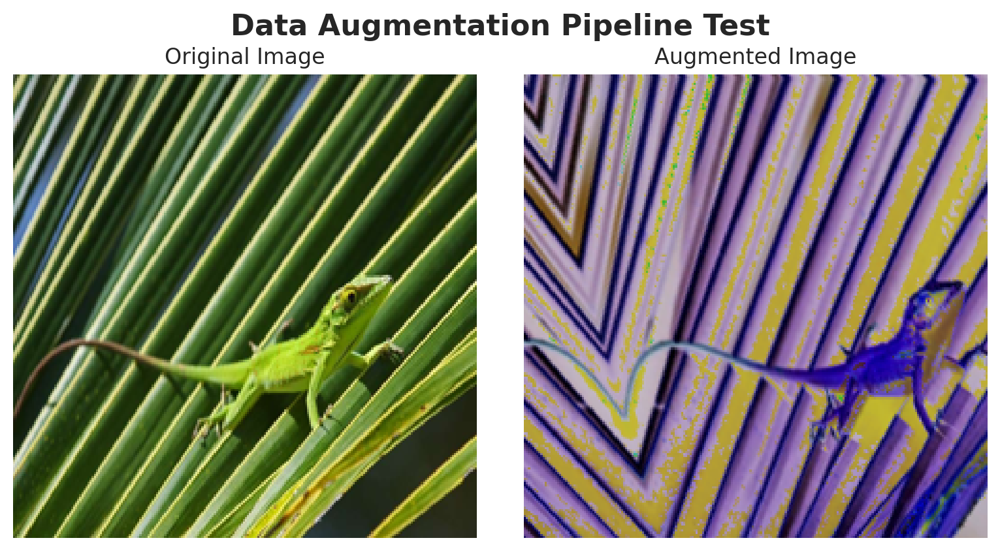


Data Augmentation Pipeline Test (Image 2):


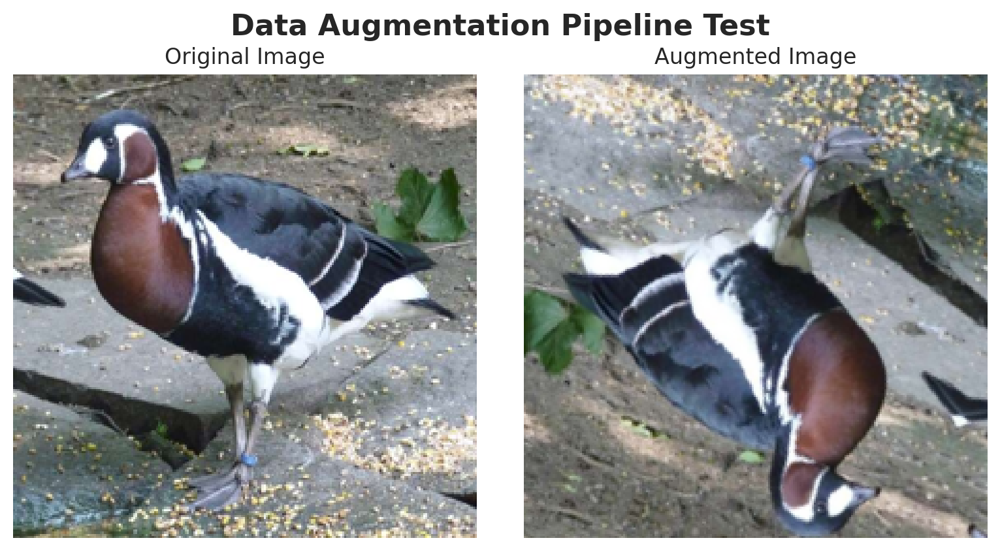

In [25]:
# Step 3.1: Test the Data Augmentation Pipeline
# Test the augmentation pipeline on a sample image
def test_augmentation_pipeline(image_path='data/RareSpecies_Split/train/chordata_dactyloidae/29482917_453292_eol-full-size-copy.jpg'):
    """Tests the data augmentation pipeline on a sample image.
    
    Args:
        image_path (str): Path to the sample image.
    
    Returns:
        None: Displays the original and augmented images.
    
    Notes:
        - Loads image, resizes to 224x224, rescales to [0, 1].
        - Applies the defined data augmentation pipeline.
        - Displays original and augmented images side by side.
    """
    # Load and preprocess the image
    try:
        original_img = Image.open(image_path).convert('RGB')
        img = original_img.resize((224, 224))
        img_array = np.array(img).astype("float32") / 255.0
        img_array = tf.expand_dims(img_array, 0)  # Shape: (1, 224, 224, 3)
    except Exception as e:
        print(f"Error loading image: {e}")
        return

    # Apply the data augmentation pipeline
    augmented_img = data_augmentation(img_array, training=True)

    # Plot original and augmented images
    fig, ax = plt.subplots(1, 2, figsize=(8, 4))
    ax[0].imshow(np.clip(img_array[0], 0, 1))
    ax[0].set_title("Original Image", fontsize=12)
    ax[0].axis('off')

    ax[1].imshow(np.clip(augmented_img[0], 0, 1))
    ax[1].set_title("Augmented Image", fontsize=12)
    ax[1].axis('off')

    plt.tight_layout()
    plt.suptitle("Data Augmentation Pipeline Test", fontsize=16, fontweight='bold', y=1.05)
    plt.show()
# Run the test with two example images
print("\nData Augmentation Pipeline Test (Image 1):")
test_augmentation_pipeline()
print("\nData Augmentation Pipeline Test (Image 2):")
test_augmentation_pipeline(image_path='data/RareSpecies_Split/train/chordata_anatidae/14020527_45513542_eol-full-size-copy.jpg')

In [ ]:
# Step 4: Generate and Save Augmented Images for Minority Classes
# Loop through each minority class
for class_name, current_count in tqdm(minority_classes.items(), desc="Augmenting Classes"):
    
    # Calculate the number of images to generate
    num_to_generate = target_count - current_count
    
    # Verify if the number is greater than zero
    if num_to_generate <= 0:
        continue                                        # Should not happen based on filter, but safe check
    
    # Create a directory for the augmented images of this class
    class_path = train_DataAugmentationSMOTE_dir / class_name       # Path to the class directory
    original_image_paths = list(class_path.glob('*'))               # Get list of original images for this class

    # Check if original images exist (Debugging)
    if not original_image_paths:
        print(f"Warning: No original images found for class {class_name}. Skipping.")
        continue
    
    # Generate the required number of augmented images
    for i in range(num_to_generate):
        # Randomly select an original image from this class
        original_image_path = random.choice(original_image_paths)

        try:
            # Load the original image
            img = load_img(original_image_path, target_size=image_size)
            img_array = img_to_array(img)            # Convert to numpy array
            img_array = img_array / 255.0            # Rescale to [0, 1] (important because augmentation layers expect this range)
            img_array = tf.expand_dims(img_array, 0) # Add batch dimension (1, H, W, C)

            # Apply the Augmentation Pipeline
            # Source: https://stackoverflow.com/questions/71455053/data-augmentation-layer-in-keras-sequential-model
            # Note: training=True ensures that random layers are activated
            augmented_img_array = data_augmentation(img_array, training=True)

            # Remove batch dimension and ensure correct data type/range for saving
            # Source: https://www.tensorflow.org/api_docs/python/tf/squeeze
            augmented_img_squeezed = tf.squeeze(augmented_img_array, axis=0).numpy()
            
            # Clip values to be safe, though rescaling usually handles this
            # Source: https://numpy.org/doc/stable/reference/generated/numpy.clip.html
            augmented_img_clipped = np.clip(augmented_img_squeezed * 255.0, 0, 255).astype(np.uint8)

            # Create a unique filename for the augmented image
            # Source: https://docs.python.org/3/library/pathlib.html#pathlib.PurePath.stem
            #         https://docs.python.org/3/library/datetime.html#strftime-and-strptime-format-codes
            #         https://docs.python.org/3/library/datetime.html#strftime-strptime-behavior
            original_stem = original_image_path.stem # Filename without extension
            timestamp = datetime.datetime.now().strftime("%Y%m%d%H%M%S%f")          # High precision timestamp
            augmented_filename = f"{original_stem}_aug_{i+1}_{timestamp}.jpg"       # Added counter and timestamp
            save_path = class_path / augmented_filename

            # Save the augmented image
            # Source: https://www.tensorflow.org/api_docs/python/tf/keras/utils/save_img
            save_img(save_path, augmented_img_clipped)

        except Exception as e:
            print(f"\nError processing {original_image_path} for class {class_name}: {e}")
            
## Time to Execute the "SMOTE" Augmentation = 29min 7s
##                                           Augmenting Classes: 100%|██████████| 200/200 [29:07<00:00,  8.74s/it]

Augmenting Classes: 100%|██████████| 200/200 [29:07<00:00,  8.74s/it]


In [27]:
# Verify New Counts of Augmented Images
# Source: https://docs.python.org/3/library/os.html#os.listdir
#         https://docs.python.org/3/library/pathlib.html#pathlib.PurePath.glob
final_class_counts = {}
for class_name in os.listdir(train_DataAugmentationSMOTE_dir):
    class_path = train_DataAugmentationSMOTE_dir / class_name
    if class_path.is_dir():
        final_class_counts[class_name] = len(list(class_path.glob('*')))
     
# Display 10 classes with their counts
print("\n\033[1mSample final counts:\033[0m")
for i, (cls, count) in enumerate(final_class_counts.items()):
    print(f"- {cls}: {count}")
    
    # Print first 10
    if i >= 9: 
        break


Sample final counts:
- chordata_nesospingidae: 240
- mollusca_cardiidae: 240
- chordata_callitrichidae: 240
- chordata_glareolidae: 240
- arthropoda_lucanidae: 240
- chordata_elapidae: 240
- chordata_mimidae: 240
- chordata_indriidae: 240
- chordata_cetorhinidae: 240
- chordata_cyprinodontidae: 240


In [28]:
# Check if all classes now have the target count
all_balanced = all(count == target_count for count in final_class_counts.values())
print(f"\033[1mAll classes reached target count ({target_count})?\033[0m {'Yes' if all_balanced else 'No'}")
if not all_balanced:
     print("Some classes might not have reached the target count due to errors or empty original directories.")

All classes reached target count (240)? Yes


In [ ]:
# # Zip the RareSpecies_Split dataset (with Data Augmentation SMOTE)
# cd data
# zip -r RareSpecies_Split.zip ./RareSpecies_Split/

---

#### **Weights**

In [30]:
# Count Samples in Each Class in the Original Training Set
print(f"Counting samples in original train directory: {train_dir}")
original_class_counts = {}
total_samples = 0
for class_name in class_names:
    class_path = train_dir / class_name
    if class_path.is_dir():
        count = len(list(class_path.glob('*'))) # Count image files
        original_class_counts[class_name] = count
        total_samples += count
    else:
        print(f"Warning: Expected directory not found: {class_path}")

print(f"Total original training samples: {total_samples}")

# Randomly sample 5 items from the dictionary
sampled_class_counts = dict(random.sample(original_class_counts.items(), 5))
print(f"Sample of Original class counts: {sampled_class_counts}")

Counting samples in original train directory: data/RareSpecies_Split/train
Total original training samples: 9586
Sample of Original class counts: {'chordata_otariidae': 48, 'chordata_delphinidae': 96, 'chordata_geoemydidae': 72, 'cnidaria_acroporidae': 168, 'chordata_aotidae': 48}


In [31]:
# Calculate Class Weights
# Formula: weight_for_class_i = (total_samples / (num_classes * samples_in_class_i))  -> This gives higher weight to smaller classes.
class_weights = {}
for class_name, count in original_class_counts.items():
    if count == 0:
        print(f"Warning: Class '{class_name}' has 0 samples. Assigning weight 0.")
        weight = 0.0
    else:
        weight = (total_samples) / (len(class_names) * count)

    # Get the index for this class name
    class_index = class_indices[class_name]
    class_weights[class_index] = weight

# Print weights for the first few classes as an example
print("\n\033[1mClass Weights:\033[0m")
for i in range(min(10, len(class_names))):
    class_name = class_names[i]
    count = original_class_counts.get(class_name, 0)
    print(f"- Class '{class_name:23}' (Index {i}): Count={count:3}, Weight={class_weights[i]:.4f}")


Class Weights:
- Class 'arthropoda_apidae      ' (Index 0): Count=120, Weight=0.3955
- Class 'arthropoda_attelabidae ' (Index 1): Count= 24, Weight=1.9773
- Class 'arthropoda_carabidae   ' (Index 2): Count= 48, Weight=0.9887
- Class 'arthropoda_cerambycidae' (Index 3): Count= 24, Weight=1.9773
- Class 'arthropoda_coenagrionidae' (Index 4): Count= 24, Weight=1.9773
- Class 'arthropoda_formicidae  ' (Index 5): Count=233, Weight=0.2037
- Class 'arthropoda_gomphidae   ' (Index 6): Count= 48, Weight=0.9887
- Class 'arthropoda_lucanidae   ' (Index 7): Count= 24, Weight=1.9773
- Class 'arthropoda_nymphalidae ' (Index 8): Count= 24, Weight=1.9773
- Class 'arthropoda_palinuridae ' (Index 9): Count= 24, Weight=1.9773


---

# **🔗 Bibliography/References**

**[[1]](https://www.tensorflow.org/api_docs/python/tf/image)** TensorFlow API Documentation - Image Module (2024). TensorFlow. Retrieved from [TensorFlow](https://www.tensorflow.org/api_docs/python/tf/image)

**[[2]](https://www.tensorflow.org/tutorials/images/data_augmentation)** TensorFlow API Documentation - Data Augmentation (2024). TensorFlow. Retrieved from [TensorFlow](https://www.tensorflow.org/tutorials/images/data_augmentation)

<br>